# Deep Dream
This jupyter notebook contains an implementation of DeepDream, a technique by Alexander Mordvintsev. <br>

Images used here are from my last trip to southwest Bavaria in <b>Decemeber, 2019</b>.<br>

Following things are covered:
<ol>
<li>Getting Data</li>
<li>Dreaming</li>
<li>Model Building</li>
<li>Takeaways</li>
</ol>

In [1]:
# import libraries
import tensorflow as tf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import random 
import scipy.ndimage as nd
import warnings
warnings.filterwarnings('ignore')

In [2]:
physical_devices = tf.config.experimental.list_physical_devices('GPU')
assert len(physical_devices) > 0, "Not enough GPU hardware devices available"
tf.config.experimental.set_memory_growth(physical_devices[0], True)

In [3]:
# load different models
#inception_model = tf.keras.applications.InceptionV3(include_top=False, weights='imagenet')
#inception_model = tf.keras.applications.VGG16(include_top=False, weights='imagenet')
inception_model = tf.keras.applications.InceptionResNetV2(include_top=False, weights='imagenet')

In [4]:
# summary
inception_model.summary()

Model: "inception_resnet_v2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
________________________________________________________________________________

In [10]:
# Maximize the activations of these layers
#names = ['mixed3','mixed5', 'mixed7']
#names = ['block2_conv2','block3_conv3']
names = ['mixed_5b','block35_1_mixed']
# Layers
layers = [inception_model.get_layer(name).output for name in names]

# Create the feature extraction model
deepdream_inception_model = tf.keras.Model(inputs=inception_model.input, outputs=layers)

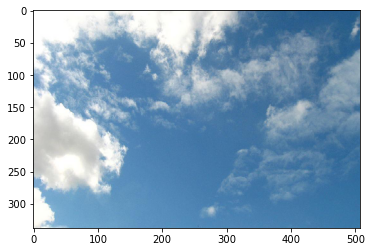

In [6]:
# import image
Picture1 = tf.keras.preprocessing.image.load_img(r'./Images/cloud.jpg', target_size = (338, 508))
plt.imshow(Picture1)

In [7]:
# shape of image
np.shape(Picture1)

(338, 508, 3)

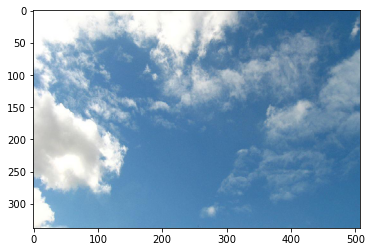

In [8]:
# Normalize the input image
Picture1_Image = np.array(Picture1)/255.0
Picture1_Image.shape
plt.imshow(Picture1_Image)

In [9]:
# convert image to array
Picture1_Image = tf.keras.preprocessing.image.img_to_array(Picture1_Image)
# preprocess image 
Picture1_Image = tf.Variable(tf.keras.applications.inception_v3.preprocess_input(Picture1_Image))
# reshape image
Picture1_Image = tf.expand_dims(Picture1_Image, axis = 0)
np.shape(Picture1_Image)

TensorShape([1, 338, 508, 3])

In [10]:
# Feed the image to model and get the activation
activations = deepdream_inception_model(Picture1_Image)

# should return 2 because we asked for 2 layers to maximize
len(activations)

3

In [5]:
def calc_loss(image, model):
# Function used for loss calculations
# It works by feedforwarding the input image through the network and generate activations
# Then obtain the average and sum of those outputs

  img_batch = tf.expand_dims(image, axis=0) # Convert into batch format
  layer_activations = model(img_batch) # Run the model
  print('ACTIVATION VALUES (LAYER OUTPUT) =\n', layer_activations)
  # print('ACTIVATION SHAPE =\n', np.shape(layer_activations))

  losses = [] # accumulator to hold all the losses
  for act in layer_activations:
    loss = tf.math.reduce_mean(act) # calculate mean of each activation 
    losses.append(loss)
  
  print('LOSSES (FROM MULTIPLE ACTIVATION LAYERS) = ', losses)
  print('LOSSES SHAPE (FROM MULTIPLE ACTIVATION LAYERS) = ', np.shape(losses))
  print('SUM OF ALL LOSSES (FROM ALL SELECTED LAYERS)= ', tf.reduce_sum(losses))

  return  tf.reduce_sum(losses) # Calculate sum 

In [6]:
@tf.function
def deepdream(model, image, step_size):
    with tf.GradientTape() as tape:
      # This needs gradients relative to `img`
      # `GradientTape` only watches `tf.Variable`s by default
      tape.watch(image)
      loss = calc_loss(image, model) # call the function that calculate the loss 

    # Calculate the gradient of the loss with respect to the pixels of the input image.
    # The syntax is as follows: dy_dx = g.gradient(y, x) 
    gradients = tape.gradient(loss, image)

    print('GRADIENTS =\n', gradients)
    print('GRADIENTS SHAPE =\n', np.shape(gradients))

    # tf.math.reduce_std computes the standard deviation of elements across dimensions of a tensor
    gradients /= tf.math.reduce_std(gradients)  

    # In gradient ascent, the "loss" is maximized so that the input image increasingly "excites" the layers.
    # You can update the image by directly adding the gradients (because they're the same shape!)
    
    image = image + gradients * step_size
    
    image = tf.clip_by_value(image, -1, 1)

    return loss, image

In [7]:
def deprocess(image):
  image = 255*(image + 1.0)/2.0
  return tf.cast(image, tf.uint8)

In [8]:
def run_deep_dream_simple(model, image, steps=100, step_size=0.01):
  # Convert from uint8 to the range expected by the model.
  h, w = image.shape[:2]
  s = 0.05 # scale coefficient
  image = tf.keras.applications.inception_v3.preprocess_input(image)
  #image2 = tf.keras.applications.inception_v3.preprocess_input(np.array(tf.keras.preprocessing.image.load_img(r'./Images/Picture1.jpg', target_size = (338, 508))))

  for step in range(steps):
      
    img = nd.affine_transform(image, [1-s,1-s,1], [h*s/2,w*s/2,0], order=2)
    
    #if step % 100 == 0 and step != 0 :
        #img = tf.constant(np.array(img))
        #base_shape = tf.shape(img)[:-1]

        #float_base_shape = tf.cast(base_shape, tf.float32)
        #new_shape = tf.cast(float_base_shape*(4**2), tf.int32)
        #img = tf.image.resize(img, new_shape).numpy()
        #img = tf.image.central_crop(img, 0.5).numpy()
        #img = tf.image.resize(img, base_shape).numpy()


    #image = nd.zoom(image, 2, order=0)
    #image = tf.keras.applications.inception_v3.preprocess_input(image)
    #print(image.shape)
    #image2 = nd.affine_transform(image, [1-s,1-s,1], [h*s/3,w*s/3,0], order=1)
    #print((image2/(step+1)).max())
    #image_mask = (image >= 1)
    #new_array = np.copy(image)
    #new_array[image_mask] = image2[image_mask]
    #image = new_array #image-(image2/(step+1)).min()


    loss, image = deepdream(model, img, step_size)
    
    if step % 10 == 0:
      plt.figure(figsize=(12,12))
      plt.imshow(deprocess(image))
      plt.show()
      print ("Step {}, loss {}".format(step, loss))

  # clear_output(wait=True)
  plt.figure(figsize=(12,12))
  plt.imshow(deprocess(image))
  plt.show()

  return deprocess(image)

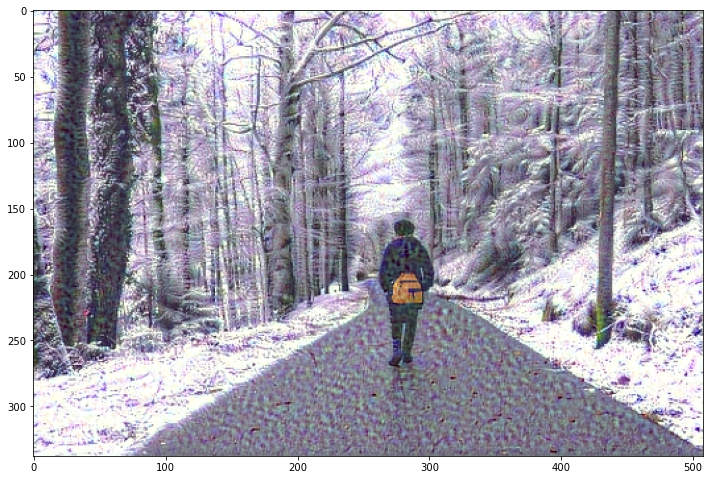

Step 0, loss 6.8948974609375


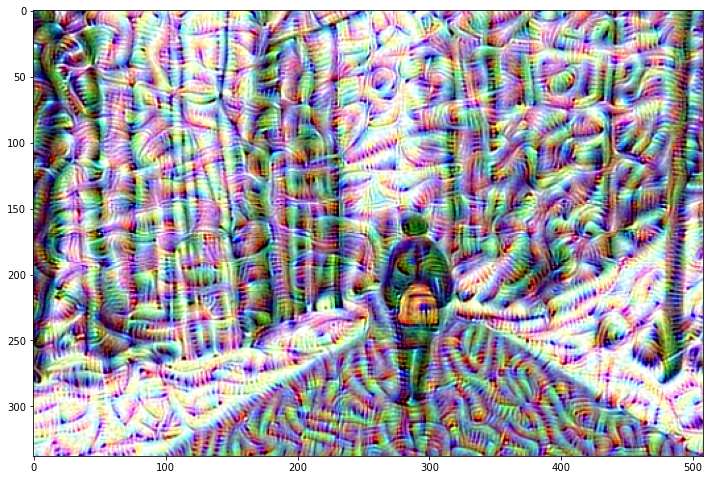

Step 5, loss 15.9161376953125


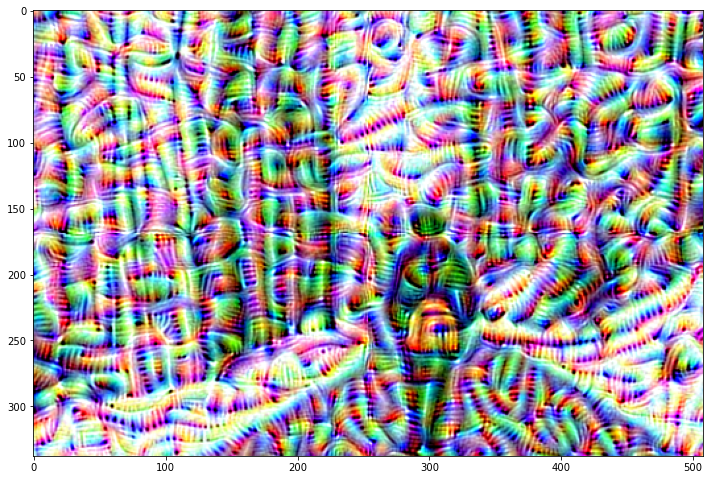

Step 10, loss 18.67786407470703


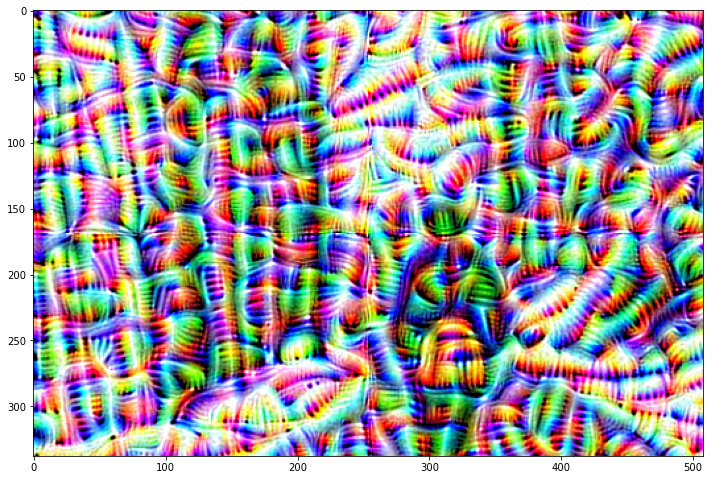

Step 15, loss 19.304866790771484


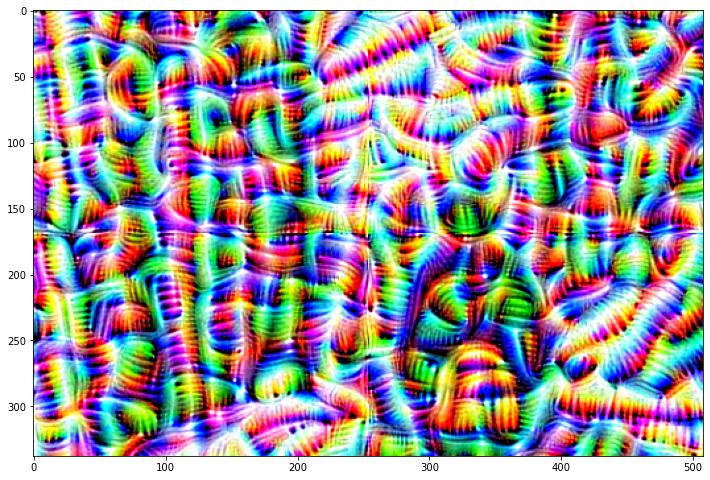

Step 20, loss 19.245399475097656


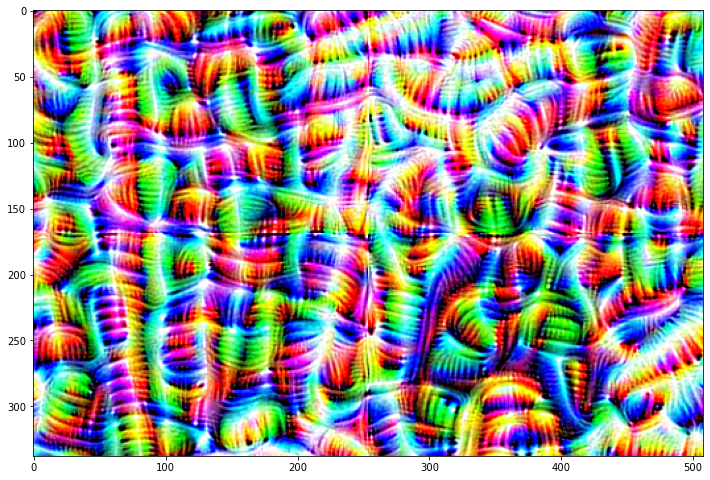

Step 25, loss 18.891998291015625


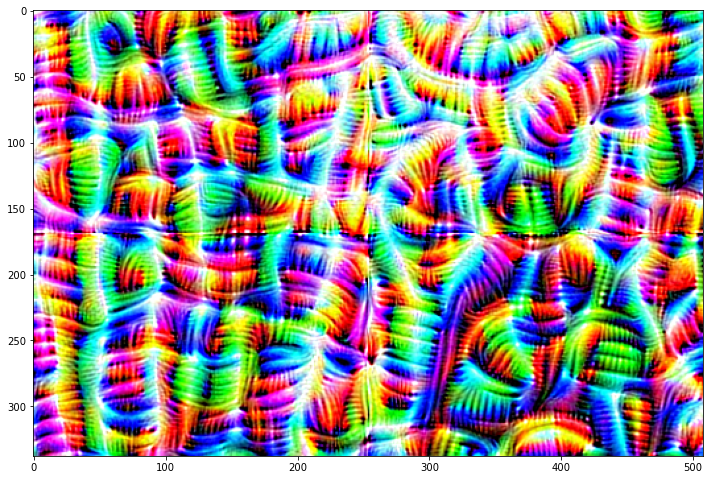

Step 30, loss 18.58368682861328


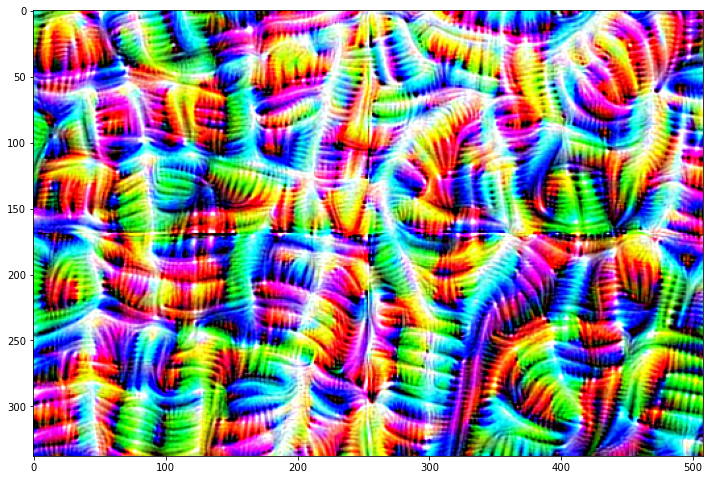

Step 35, loss 18.343935012817383


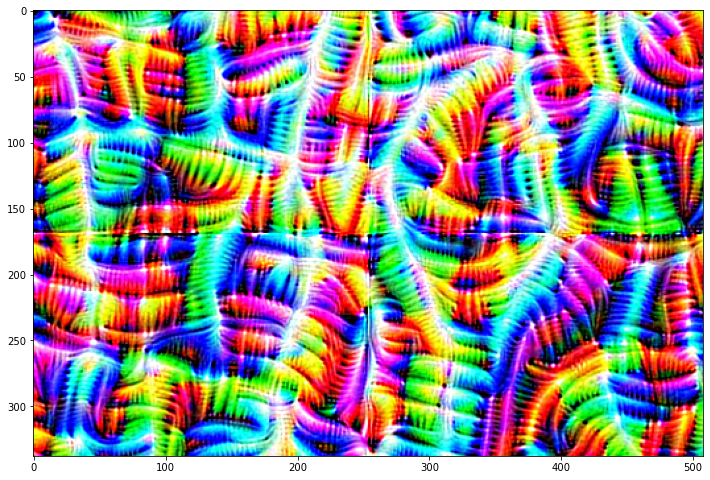

Step 40, loss 18.197647094726562


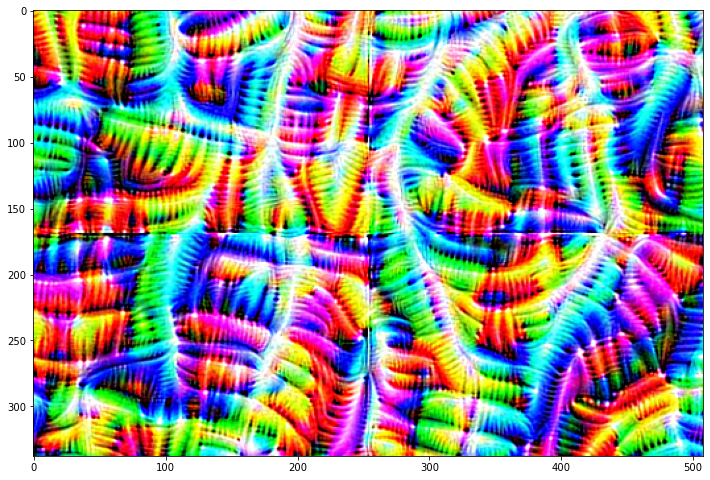

Step 45, loss 18.05033302307129


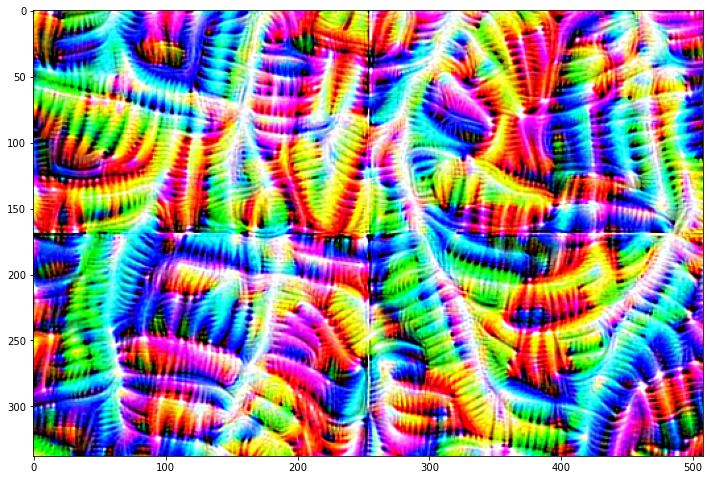

Step 50, loss 18.052743911743164


KeyboardInterrupt: 

In [396]:
#Sample_Image= tf.keras.preprocessing.image.load_img(r'./Images/cloud.jpg', target_size = (338, 508))

Sample_Image2 = tf.keras.preprocessing.image.load_img(r'./Images/Picture5.jpg', target_size = (338, 508))
#Sample_Image1 = tf.keras.preprocessing.image.load_img(r'./Images/Picture1.jpg', target_size = (338, 508))
#Sample_Image = Image.blend(Sample_Image1, Sample_Image2, alpha=.3)
# Sample_Image= tf.keras.preprocessing.image.load_img(r'/content/drive/My Drive/Colab Notebooks/StaryNight.jpg', target_size = (225, 375))

# Sample_Image = np.array(Sample_Image)/255.0
Sample_Image = tf.keras.preprocessing.image.img_to_array(Sample_Image2)
Sample_Image = np.array(Sample_Image)
# Sample_Image = tf.keras.applications.inception_v3.preprocess_input(Sample_Image)
dream_img = run_deep_dream_simple(model=deepdream_inception_model, image=Sample_Image, 
                                  steps=1000, step_size=0.1)

-5
ACTIVATION VALUES (LAYER OUTPUT) =
 [<tf.Tensor 'model/mixed_5b/concat:0' shape=(1, 23, 37, 320) dtype=float32>, <tf.Tensor 'model/block35_1_mixed/concat:0' shape=(1, 23, 37, 128) dtype=float32>]
LOSSES (FROM MULTIPLE ACTIVATION LAYERS) =  [<tf.Tensor 'Mean:0' shape=() dtype=float32>, <tf.Tensor 'Mean_1:0' shape=() dtype=float32>]
LOSSES SHAPE (FROM MULTIPLE ACTIVATION LAYERS) =  (2,)
SUM OF ALL LOSSES (FROM ALL SELECTED LAYERS)=  Tensor("Sum:0", shape=(), dtype=float32)
GRADIENTS =
 Tensor("gradient_tape/Reshape_3:0", shape=(209, 315, 3), dtype=float32)
GRADIENTS SHAPE =
 (209, 315, 3)


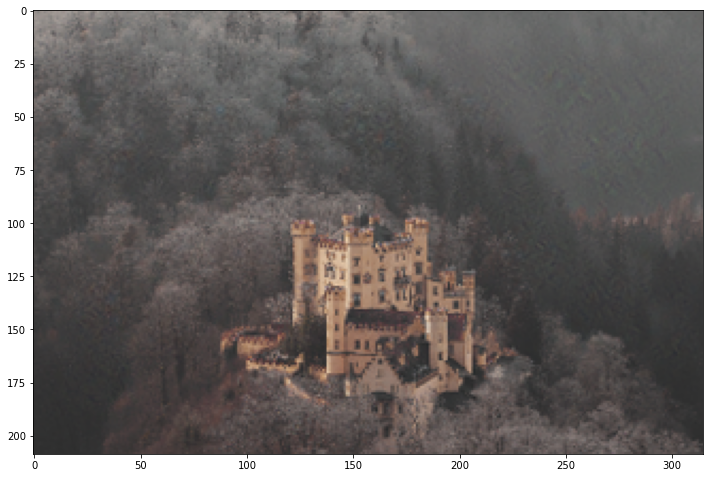

Step 0, loss 0.6644651889801025


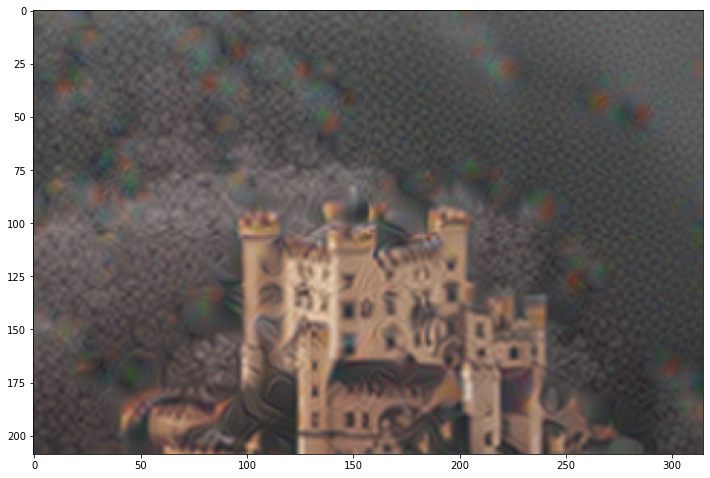

Step 10, loss 0.7827762961387634


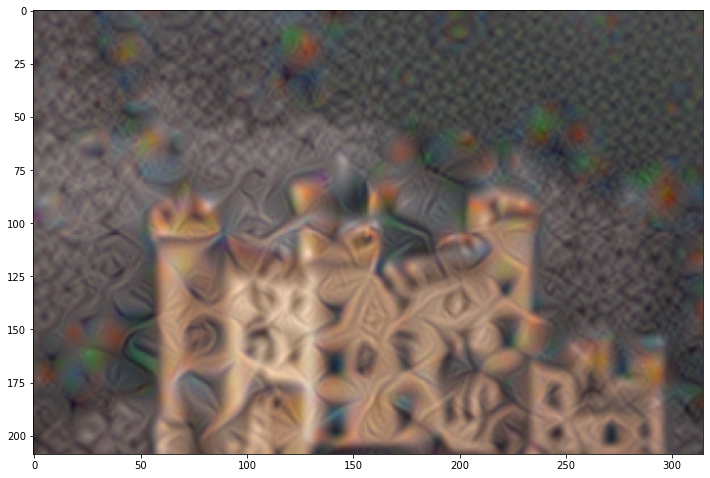

Step 20, loss 0.8175106048583984


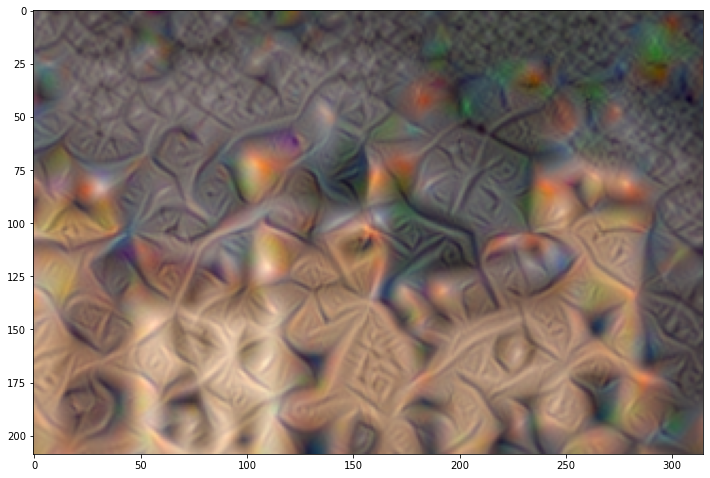

Step 30, loss 0.8687847852706909


KeyboardInterrupt: 

In [11]:
import time
from PIL import Image

start = time.time()

OCTAVE_SCALE = 1.1
Sample_Image = tf.keras.preprocessing.image.load_img(r'./Images/Picture1.jpg', target_size = (338, 508))
img = tf.constant(np.array(Sample_Image))
base_shape = tf.shape(img)[:-1]
float_base_shape = tf.cast(base_shape, tf.float32)

for n in range(-5, 5):
  print(n)
  new_shape = tf.cast(float_base_shape*(OCTAVE_SCALE**n), tf.int32)

  img = tf.image.resize(img, new_shape).numpy()

  img = run_deep_dream_simple(model=deepdream_inception_model, image=img, steps=100, step_size=0.01)

#display.clear_output(wait=True)
#img = tf.image.resize(img, base_shape)
#img = tf.image.convert_image_dtype(img/255.0, dtype=tf.uint8)
#show(img)

In [377]:
np.shape(tf.keras.preprocessing.image.load_img(r'./Images/Picture6.jpg'))

(6000, 4000, 3)

In [202]:
Sample_Image= tf.keras.preprocessing.image.load_img(r'./Images/cloud.jpg', target_size = (338, 508))
Sample_Image = np.array(Sample_Image)
x = tf.keras.applications.inception_v3.preprocess_input(Sample_Image)
ch = x.shape[0]

In [333]:
Sample_Image = tf.keras.preprocessing.image.load_img(r'./Images/Picture3.jpg', target_size = (338, 508))
img = tf.constant(np.array(Sample_Image))
base_shape = tf.shape(img)[:-1]

float_base_shape = tf.cast(base_shape, tf.float32)
new_shape = tf.cast(float_base_shape*(2**2), tf.int32)
img = tf.image.resize(img, new_shape).numpy()

img1 = tf.image.central_crop(img, 0.5).numpy()



#run_deep_dream_simple(model=deepdream_inception_model, image=img, steps=100, step_size=0.02)

In [337]:
img.shape

(1352, 2032, 3)

In [336]:
img1.shape

(676, 1016, 3)

In [160]:
y = tf.keras.applications.inception_v3.preprocess_input(np.array(tf.keras.preprocessing.image.load_img(r'./Images/Picture1.jpg', target_size = (338, 508))))

In [154]:
x = x.reshape(ch,-1)
y = y.reshape(ch,-1)
A = x.T.dot(y) # compute the matrix of dot-products with guide features

In [157]:
Sample_Image.reshape(ch,-1)[:] = y[:,A.argmax(1)]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


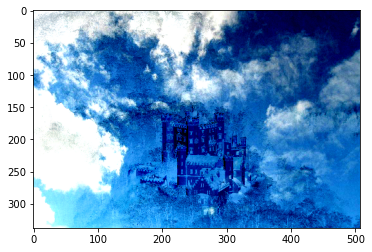

In [173]:
plt.imshow(x-y)
plt.show()

In [145]:
x

array([[[ 1.        ,  1.        ,  1.        ],
        [ 1.        ,  1.        ,  1.        ],
        [ 1.        ,  1.        ,  1.        ],
        ...,
        [-0.6862745 , -0.27843136,  0.09803927],
        [-0.6784314 , -0.27058822,  0.10588241],
        [-0.67058825, -0.26274508,  0.11372554]],

       [[ 1.        ,  1.        ,  1.        ],
        [ 1.        ,  1.        ,  1.        ],
        [ 1.        ,  1.        ,  1.        ],
        ...,
        [-0.6784314 , -0.27058822,  0.10588241],
        [-0.67058825, -0.26274508,  0.11372554],
        [-0.6627451 , -0.25490195,  0.12156868]],

       [[ 1.        ,  1.        ,  1.        ],
        [ 1.        ,  1.        ,  1.        ],
        [ 1.        ,  1.        ,  1.        ],
        ...,
        [-0.654902  , -0.24705881,  0.12941182],
        [-0.64705884, -0.23921567,  0.13725495],
        [-0.6392157 , -0.23137254,  0.14509809]],

       ...,

       [[ 0.8352941 ,  0.84313726,  0.79607844],
        [ 0

In [26]:
x = img
y = tf.keras.preprocessing.image.load_img(r'./Images/Picture2.jpg', target_size = (338, 508))
ch = x.shape[0]
x = x.reshape(ch,-1)
y = y.reshape(ch,-1)
A = x.T.dot(y) # compute the matrix of dot-products with guide features
img.diff[0].reshape(ch,-1)[:] = y[:,A.argmax(1)] # select ones that match best


AttributeError: 'tensorflow.python.framework.ops.EagerTensor' object has no attribute 'reshape'

In [29]:
np.shape(y)

(338, 508, 3)

In [31]:
np.array(y).reshape(20,20,3)

ValueError: cannot reshape array of size 515112 into shape (20,20,3)

In [30]:
image.shape[0]

NameError: name 'image' is not defined